### Import Modules & Get Image

In [9]:
import numpy as np
import cv2
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt

## Select Image

In [2]:
#@title Image Name
image_name = "threecliffs.jpg"# @param{type:"string"}

## Get image

/content/drive/MyDrive/Personal/Art/threecliffs.jpg


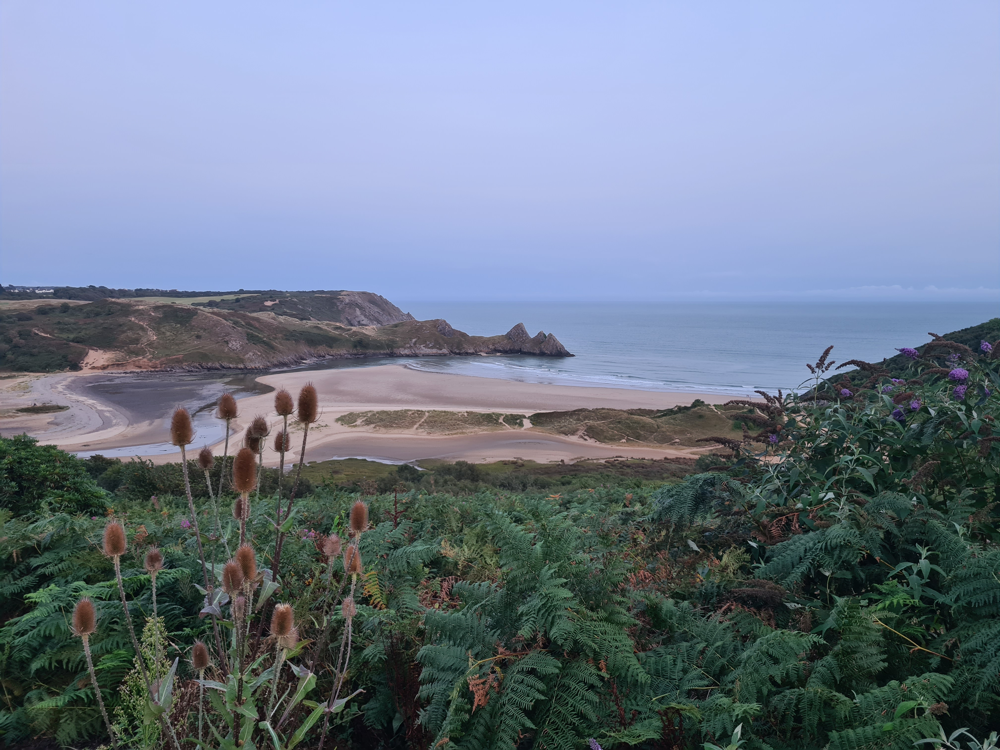

In [3]:
combine = "/content/drive/MyDrive/Personal/Art/"+str(image_name)
print(combine)
trial = combine
image =cv2.imread(trial)
cv2_imshow(image)

##Image size and colour

In [ ]:
# img.shape. It returns a tuple of the number of rows, columns, and channels (if the image is color):
print("Height:", image.shape[0],". Width:",image.shape[1],". Colour Channels:",image.shape[2])

# access a pixel value by its coordinates.
# BGR image returns array
# For grayscale image intensity returned
pix = image[100, 100]
# Example pixel
print("\nPixel at element [100,100] has value:")
print("Blue:", pix[0],", Green:", pix[1],", Red:", pix[2])

Height: 3024 . Width: 4032 . Colour Channels: 3

Pixel at element [100,100] has value:
Blue: 237 , Green: 192 , Red: 179


# Invert and/or Turn to black and white if needed

In [4]:
#@title  Invert Pixels { run: "auto" }
image = (255-image)

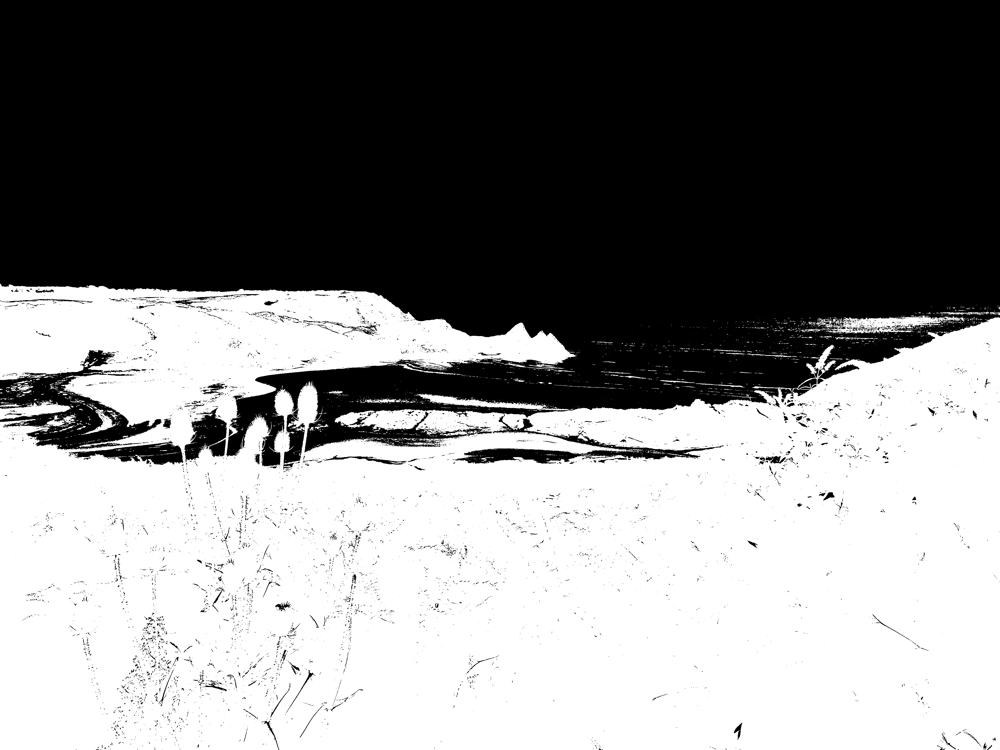

In [17]:
# turn the image from colour to b&w using an adjustable threshold
#@title Pixel to Black Threshold Slider{ run: "auto" }
bw_threshold = 24 #@param {type:"slider", min:0, max:255, step:1}
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
discard, bw_image = cv2.threshold(gray_image, bw_threshold, 255, cv2.THRESH_BINARY)
# Make the image a 3d tuple
bw_image_3_channel = np.stack((bw_image, bw_image, bw_image), axis=2)
cv2_imshow(bw_image_3_channel)

In [18]:
#@title Set Image as the above { run: "auto" }
image = bw_image_3_channel

Text(0.5, 1.0, 'opening')

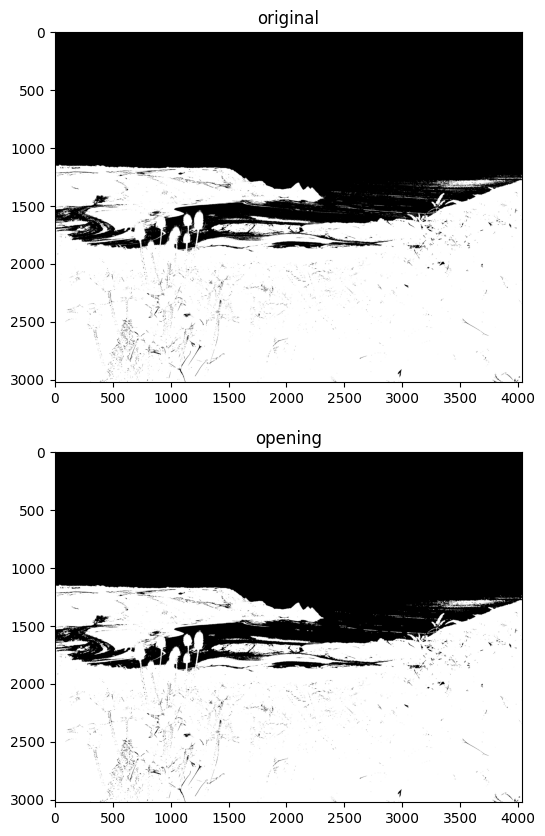

In [10]:
#@title PerformOpening{ run: "auto" }
Opening_Iterations = 1 #@param {type:"slider", min:0, max:50, step:1}

kernel = np.ones((3,3),np.uint8) # this shows us we are using 8 adjacent as we have a centre pixel surrounded by 8.
er_kernel = cv2.getStructuringElement(cv2.MORPH_CROSS,(3,3))
# erosion = cv2.erode(image,er_kernel,iterations = 2)
opening = cv2.morphologyEx(image, cv2.MORPH_OPEN, er_kernel, iterations=Opening_Iterations)
# because black is what we want, opening and erosion are reversed here
# opening will increase the white pixels - eroding the drawing,
# erosion will increase the black pixels - expanding the drawing.
# therefore erode then open.

plt.figure(figsize=(10, 10))
plt.subplot(2,1,1)
plt.imshow(image)
plt.title("original")
plt.subplot(2,1,2)
plt.imshow(opening)
plt.title("opening")
# plt.subplot(3,1,3)
# plt.imshow(opening)
# plt.title("opening & erosion")
# plt.show()



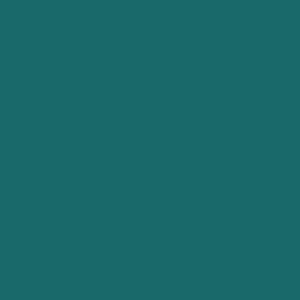

In [11]:
# Select a colour to replace either the black or white pixels
#@title Colour Picker{ run: "auto" }
r = 24 #@param {type:"slider", min:0, max:255, step:1}
g = 105 #@param {type:"slider", min:0, max:255, step:1}
b = 106   #@param {type:"slider", min:0, max:255, step:1}
colour = (r,g,b)
from PIL import Image
img = Image.new('RGB', (300,300), color = colour)
display(img)

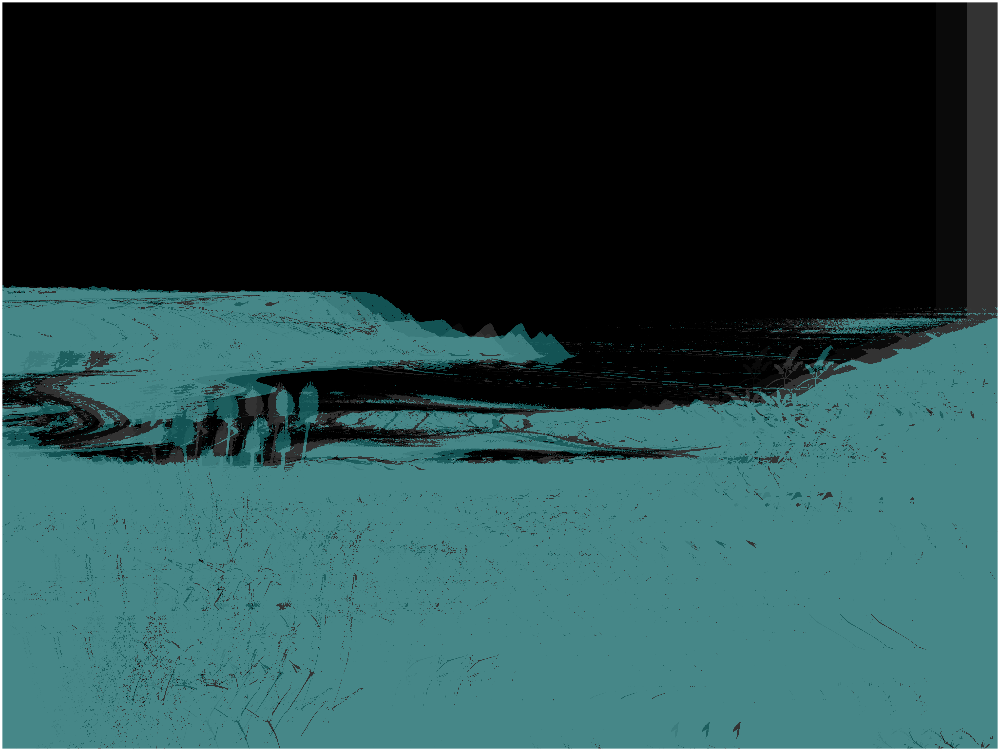

In [22]:
# colour variant maker function
def colour_image(image, colourBlack, threshold=100):
  light_image = image.copy()
  green_image = image.copy()
  dark_image = image.copy()
  # Iterate over each pixel
  for i in range(dark_image.shape[0]):
    for j in range(dark_image.shape[1]):
      # Check if all color channels are below the threshold
      if colourBlack == False:
        if dark_image[i, j][0] > threshold and dark_image[i, j][1] > threshold and dark_image[i, j][2] > threshold:
          # Set the pixel to the colour
          light_image[i, j] = colour
          green_image[i, j] = [255,255,255]#[120, 190, 120]
          dark_image[i, j] = [255,255,255]#[100, 190, 100]
      else:
        if dark_image[i, j][0] < threshold and dark_image[i, j][1] < threshold and dark_image[i, j][2] < threshold:
          # Set the pixel to the colour
          light_image[i, j] = colour
          green_image[i, j] = [255,255,255]#[120, 190, 120]
          dark_image[i, j] = [255,255,255]#[100, 190, 100]
  return light_image, green_image, dark_image

# Apply the colouring function to the eroded image
#@title Overlapinator{ run: "auto" }
select = image# @param ["image","opening"] {type:"raw"}
Colour_Black_Pixels = False # @param {type:"boolean"}
light,green,dark= colour_image(select, Colour_Black_Pixels,threshold=120)


# Display the second image with an offset
# The extent values are [left, right, bottom, top]
X_layer_Offset = 125 #@param {type:"slider", min:0, max:255, step:1}
x_offset = X_layer_Offset # Adjust the horizontal offset
y_offset = 0 # No vertical offset at the moment


# Display the third image with a different offset
x_offset_dark = 2*X_layer_Offset # Adjust the horizontal offset
y_offset_dark = 0# No vertical offset at the moment
Top_Transparency = 0.8 #@param {type:"slider", min:0, max:1, step:0.1}





# set aspect ratio
aspect_ratio = 1.41 # A4 ratio
original_height, original_width, _ = light.shape
current_aspect_ratio = original_height / original_width

# Determine the new dimensions
if current_aspect_ratio < aspect_ratio:
    # Width is limiting dimension, increase height
    new_height = int(original_width * aspect_ratio)
    new_width = original_width
else:
    # Height is limiting dimension, increase width
    new_width = int(original_height / aspect_ratio)
    new_height = original_height

# Create a white canvas
padded_image = np.full((new_height, new_width, 3), 255, dtype=np.uint8)

# Calculate the position to paste the original image
y_offset = (new_height - original_height) // 2
x_offset = (new_width - original_width) // 2

padded_image[y_offset:y_offset + original_height, x_offset:x_offset + original_width] = light # or green or dark, depending on which layer you want to use for size

plt.figure(figsize=(new_width/100, new_height/100)) # Adjust figure size to match dims

ax = plt.axes([0, 0, 1, 1]) # [left, bottom, width, height] in figure coordinates

ax.imshow(padded_image, extent=[0, new_width, 0, new_height]) # Display the white background

# Display the three layers
ax.imshow(dark, extent=[x_offset + 0, dark.shape[1] + x_offset + 0, y_offset + 0, dark.shape[0] + y_offset + 0])
ax.imshow(green, alpha=0.8, extent=[x_offset + X_layer_Offset, green.shape[1] + x_offset + X_layer_Offset, y_offset + 0, green.shape[0] + y_offset + 0])
ax.imshow(light, alpha=Top_Transparency, extent=[x_offset + 2*X_layer_Offset, light.shape[1] + x_offset + 2*X_layer_Offset, y_offset + 0, light.shape[0] + y_offset + 0])





ax.axis('off')
Save_Output = True # @param {type:"boolean"}
Name= "threeCliffsPrint" # @param {type:"string"}
if Save_Output == True:
  combine2 = "/content/drive/MyDrive/Personal/Art/print_"+Name
  plt.savefig(combine2, bbox_inches='tight')

plt.show()